In [1]:
import zipfile
import h5py
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, f1_score, recall_score
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input, decode_predictions
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.regularizers import l2
from keras.utils import to_categorical

%matplotlib inline
np.random.seed(42)

In [2]:
# Parameter
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
COLOR_CHANNELS = 3
BATCH_SIZE = 32
EPOCHS = 25
K = 5  # Jumlah fold

In [3]:
data_dir = '../../Dataset/Dataset_Nusantara_7_split_stratified/train'

# Membuat dataframe dari dataset
image_paths = []
labels = []

for class_name in os.listdir(data_dir):
    class_dir = os.path.join(data_dir, class_name)
    if os.path.isdir(class_dir):  
        for img_name in os.listdir(class_dir):
            image_paths.append(os.path.join(class_dir, img_name))
            labels.append(class_name)

df = pd.DataFrame({"filename": image_paths, "class": labels})

# Konversi label ke angka
label_encoder = LabelEncoder()
df["label"] = label_encoder.fit_transform(df["class"])

print("✅ Dataset berhasil dimuat! Jumlah data:", len(df))
pd.set_option('display.max_colwidth', None)
df.head(len(df))

✅ Dataset berhasil dimuat! Jumlah data: 1590


,filename,class,label
0,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_0.jpg,JawaBarat_Megamendung,0
1,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_10.jpg,JawaBarat_Megamendung,0
2,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_101.jpg,JawaBarat_Megamendung,0
3,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_102.jpg,JawaBarat_Megamendung,0
4,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_104.jpg,JawaBarat_Megamendung,0
...,...,...,...
1585,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_92.jpg,Yogyakarta_Kawung,6
1586,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_93.jpg,Yogyakarta_Kawung,6
1587,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_94.jpg,Yogyakarta_Kawung,6
1588,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_96.jpg,Yogyakarta_Kawung,6


In [5]:
# Fungsi untuk membuat model MobileNetV2
def create_model():
    base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(
        weights="imagenet", include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS)
    )
    
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    
    # Menambahkan layer output dengan weight decay
    predictions = Dense(len(label_encoder.classes_), activation="softmax")(x)
    
    model = Model(inputs=base_model.input, outputs=predictions)

    # Compile model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Cek model
model = create_model()
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,266,951 (8.65 MB)

 Trainable params: 2,232,839 (8.52 MB)

 Non-trainable params: 34,112 (133.25 KB)


🔹 Training Fold 1/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
 1/40 ━━━━━━━━━━━━━━━━━━━━ 15:44 24s/step - accuracy: 0.1562 - loss: 2.4170

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7227 - loss: 0.9205
Epoch 1: val_loss improved from inf to 14.01126, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 167s 4s/step - accuracy: 0.7248 - loss: 0.9143 - val_accuracy: 0.2484 - val_loss: 14.0113
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9156 - loss: 0.3039
Epoch 2: val_loss improved from 14.01126 to 2.55837, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 134s 3s/step - accuracy: 0.9158 - loss: 0.3030 - val_accuracy: 0.6195 - val_loss: 2.5584
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8965 - loss: 0.4244
Epoch 3: val_loss did not improve from 2.55837
40/40 ━━━━━━━━━━━━━━━━━━━━ 136s 3s/step - accuracy: 0.8966 - loss: 0.4236 - val_accuracy: 0.4057 - val_loss: 7.2973
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9292 - loss: 0.2396
Epoch 4: val_loss did not improve from 2.55837
40/40 ━━━━━━━━━━━━━━━━━━━━ 133s 3s/step - accuracy: 0.9291 - loss: 0.2400 - val_accuracy: 0.4811 - val_loss: 6.9161
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9323 - loss: 0.2183
Epoch 5: val_loss did not improve from 2.55837
40/40 ━━━━━━━━━━━━━━━━━━━━ 133s 3s/step - accuracy: 0.9324 - loss: 0.2180 - val_accuracy: 0.6792 - val_loss: 6.1224
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9346 - loss: 0.1952
Epoch 6: val_loss did not improve from 2.55837
40/40 ━━━━━━━━━━

40/40 ━━━━━━━━━━━━━━━━━━━━ 134s 3s/step - accuracy: 0.9696 - loss: 0.1082 - val_accuracy: 0.7893 - val_loss: 2.3458
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9573 - loss: 0.2091
Epoch 8: val_loss did not improve from 2.34580
40/40 ━━━━━━━━━━━━━━━━━━━━ 131s 3s/step - accuracy: 0.9573 - loss: 0.2085 - val_accuracy: 0.6069 - val_loss: 4.3051
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9540 - loss: 0.1317
Epoch 9: val_loss did not improve from 2.34580
40/40 ━━━━━━━━━━━━━━━━━━━━ 128s 3s/step - accuracy: 0.9541 - loss: 0.1315 - val_accuracy: 0.5849 - val_loss: 5.6922
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9883 - loss: 0.0740
Epoch 10: val_loss did not improve from 2.34580
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9880 - loss: 0.0748 - val_accuracy: 0.6950 - val_loss: 2.4935
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9562 - loss: 0.1500
Epoch 11: val_loss did not improve from 2.34580
40/40 ━━━━━━

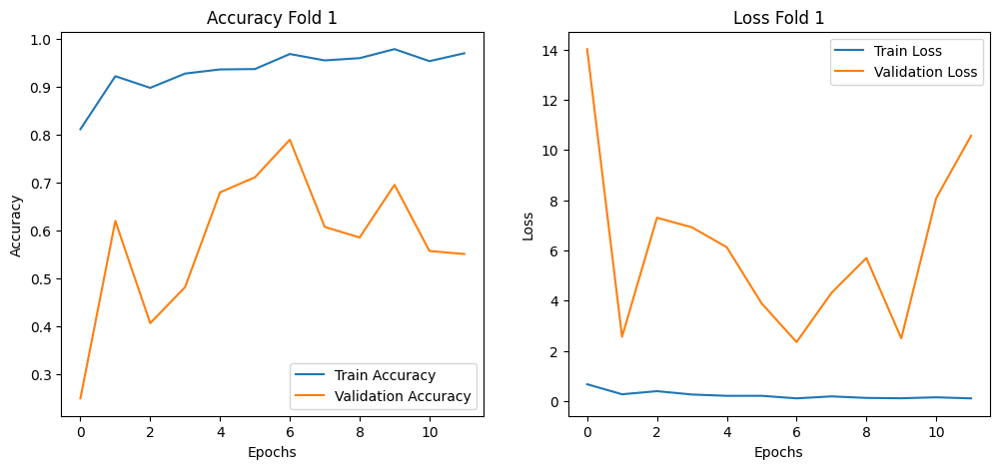


🔹 Training Fold 2/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
16/40 ━━━━━━━━━━━━━━━━━━━━ 1:14 3s/step - accuracy: 0.5410 - loss: 1.2552

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6820 - loss: 0.9239
Epoch 1: val_loss improved from inf to 3.79171, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 150s 3s/step - accuracy: 0.6849 - loss: 0.9170 - val_accuracy: 0.5818 - val_loss: 3.7917
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9144 - loss: 0.3395
Epoch 2: val_loss improved from 3.79171 to 2.83311, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9141 - loss: 0.3397 - val_accuracy: 0.6321 - val_loss: 2.8331
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9423 - loss: 0.2024
Epoch 3: val_loss did not improve from 2.83311
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9421 - loss: 0.2031 - val_accuracy: 0.3868 - val_loss: 9.7260
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9073 - loss: 0.2729
Epoch 4: val_loss did not improve from 2.83311
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9073 - loss: 0.2733 - val_accuracy: 0.3774 - val_loss: 11.1300
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9273 - loss: 0.2160
Epoch 5: val_loss did not improve from 2.83311
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9272 - loss: 0.2166 - val_accuracy: 0.4874 - val_loss: 9.2452
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9473 - loss: 0.1957
Epoch 6: val_loss did not improve from 2.83311
40/40 ━━━━━━━━━

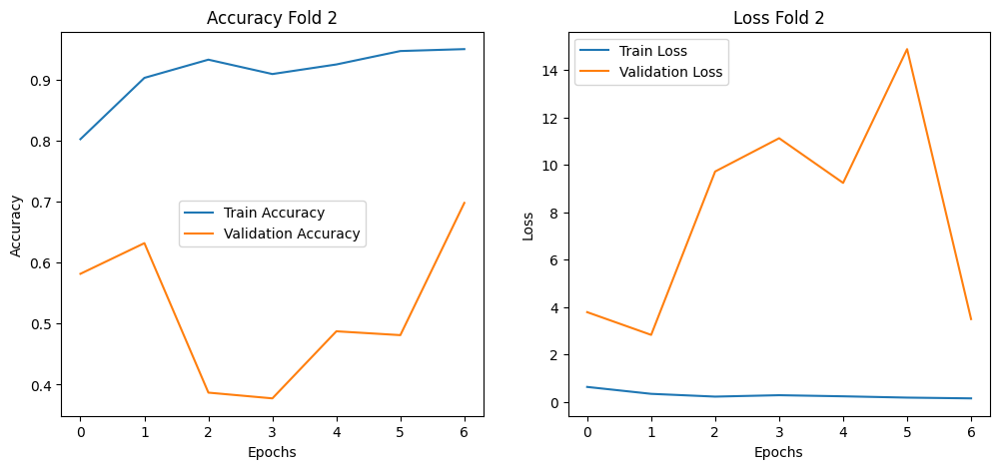


🔹 Training Fold 3/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
34/40 ━━━━━━━━━━━━━━━━━━━━ 18s 3s/step - accuracy: 0.6785 - loss: 1.0029

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6966 - loss: 0.9550
Epoch 1: val_loss improved from inf to 5.04712, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 150s 3s/step - accuracy: 0.6992 - loss: 0.9480 - val_accuracy: 0.6667 - val_loss: 5.0471
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9057 - loss: 0.3562
Epoch 2: val_loss improved from 5.04712 to 3.70881, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9054 - loss: 0.3564 - val_accuracy: 0.6855 - val_loss: 3.7088
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9044 - loss: 0.3491
Epoch 3: val_loss did not improve from 3.70881
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9041 - loss: 0.3496 - val_accuracy: 0.5975 - val_loss: 6.2335
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9420 - loss: 0.2167
Epoch 4: val_loss did not improve from 3.70881
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9419 - loss: 0.2165 - val_accuracy: 0.6667 - val_loss: 4.1583
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9579 - loss: 0.1523
Epoch 5: val_loss did not improve from 3.70881
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9576 - loss: 0.1533 - val_accuracy: 0.6038 - val_loss: 6.9506
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9430 - loss: 0.1707
Epoch 6: val_loss improved from 3.70881 to 3.34176, saving mode

40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9432 - loss: 0.1699 - val_accuracy: 0.7421 - val_loss: 3.3418
Epoch 7/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9588 - loss: 0.1253
Epoch 7: val_loss improved from 3.34176 to 3.17862, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9588 - loss: 0.1257 - val_accuracy: 0.6321 - val_loss: 3.1786
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9542 - loss: 0.1437
Epoch 8: val_loss did not improve from 3.17862
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9543 - loss: 0.1433 - val_accuracy: 0.6164 - val_loss: 5.8416
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9753 - loss: 0.0980
Epoch 9: val_loss did not improve from 3.17862
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9753 - loss: 0.0980 - val_accuracy: 0.6006 - val_loss: 5.9167
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9831 - loss: 0.0583
Epoch 10: val_loss improved from 3.17862 to 2.35575, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9830 - loss: 0.0589 - val_accuracy: 0.7610 - val_loss: 2.3558
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9724 - loss: 0.0762
Epoch 11: val_loss did not improve from 2.35575
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9726 - loss: 0.0756 - val_accuracy: 0.6195 - val_loss: 3.6736
Epoch 12/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9839 - loss: 0.0611
Epoch 12: val_loss improved from 2.35575 to 1.42246, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9838 - loss: 0.0613 - val_accuracy: 0.8208 - val_loss: 1.4225
Epoch 13/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9646 - loss: 0.1754
Epoch 13: val_loss did not improve from 1.42246
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9646 - loss: 0.1750 - val_accuracy: 0.5975 - val_loss: 3.5445
Epoch 14/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9807 - loss: 0.0533
Epoch 14: val_loss did not improve from 1.42246
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9806 - loss: 0.0534 - val_accuracy: 0.5440 - val_loss: 4.9974
Epoch 15/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9856 - loss: 0.0574
Epoch 15: val_loss did not improve from 1.42246
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9856 - loss: 0.0575 - val_accuracy: 0.5597 - val_loss: 5.1919
Epoch 16/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9883 - loss: 0.0390
Epoch 16: val_loss did not improve from 1.42246
40/40 ━━

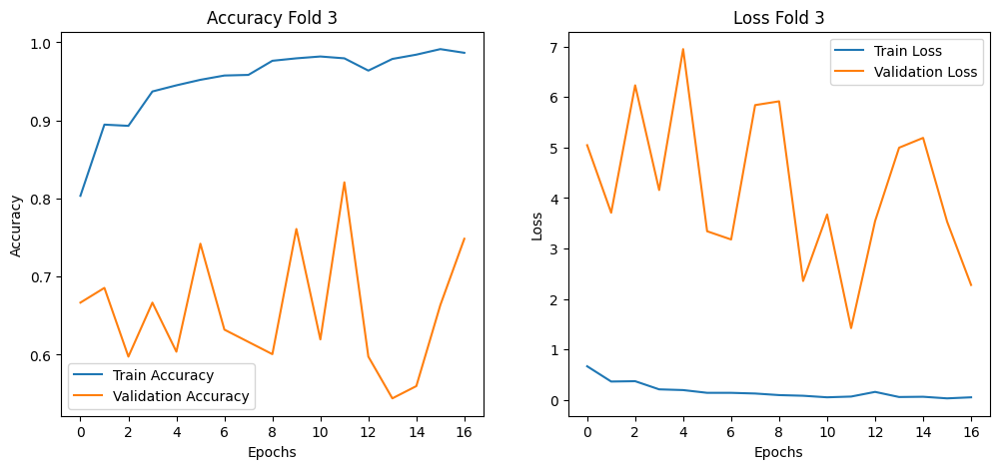


🔹 Training Fold 4/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
11/40 ━━━━━━━━━━━━━━━━━━━━ 1:29 3s/step - accuracy: 0.5416 - loss: 1.2134

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.7031 - loss: 0.8443
Epoch 1: val_loss improved from inf to 3.99095, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 151s 3s/step - accuracy: 0.7051 - loss: 0.8401 - val_accuracy: 0.5818 - val_loss: 3.9910
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9128 - loss: 0.2937
Epoch 2: val_loss improved from 3.99095 to 2.96692, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9130 - loss: 0.2933 - val_accuracy: 0.6824 - val_loss: 2.9669
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9343 - loss: 0.2199
Epoch 3: val_loss did not improve from 2.96692
40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9341 - loss: 0.2208 - val_accuracy: 0.6258 - val_loss: 3.4228
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9340 - loss: 0.2628
Epoch 4: val_loss did not improve from 2.96692
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9340 - loss: 0.2625 - val_accuracy: 0.6101 - val_loss: 6.8389
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9521 - loss: 0.1319
Epoch 5: val_loss did not improve from 2.96692
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9519 - loss: 0.1333 - val_accuracy: 0.5377 - val_loss: 8.9186
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9520 - loss: 0.1573
Epoch 6: val_loss did not improve from 2.96692
40/40 ━━━━━━━━━━

40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9443 - loss: 0.1464 - val_accuracy: 0.7547 - val_loss: 2.5595
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9454 - loss: 0.1887
Epoch 8: val_loss did not improve from 2.55945
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9450 - loss: 0.1897 - val_accuracy: 0.3585 - val_loss: 11.3342
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9682 - loss: 0.1076
Epoch 9: val_loss did not improve from 2.55945
40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9683 - loss: 0.1073 - val_accuracy: 0.5314 - val_loss: 7.3771
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9794 - loss: 0.0711
Epoch 10: val_loss did not improve from 2.55945
40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9794 - loss: 0.0711 - val_accuracy: 0.5094 - val_loss: 11.5562
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9732 - loss: 0.0881
Epoch 11: val_loss did not improve from 2.55945
40/40 ━━━━

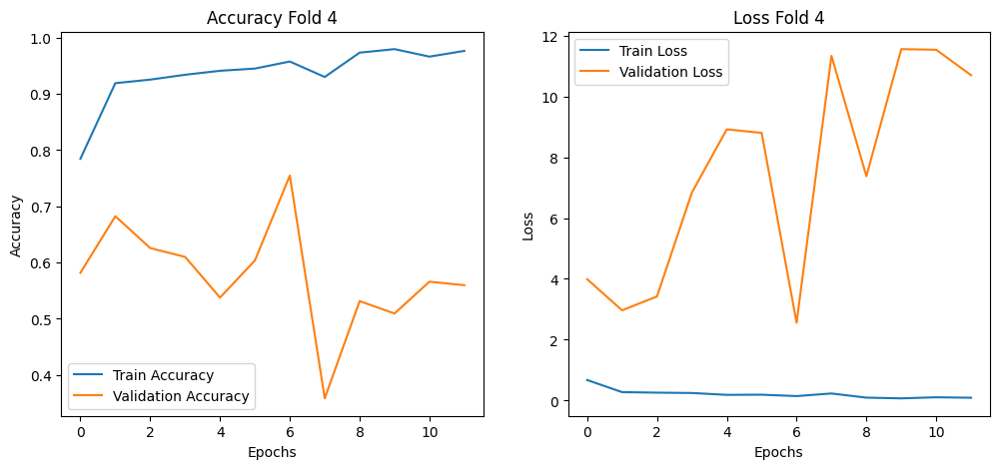


🔹 Training Fold 5/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.
Epoch 1/25


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6792 - loss: 0.9546

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(



Epoch 1: val_loss improved from inf to 4.28232, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 150s 3s/step - accuracy: 0.6818 - loss: 0.9479 - val_accuracy: 0.6509 - val_loss: 4.2823
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8701 - loss: 0.4699
Epoch 2: val_loss did not improve from 4.28232
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.8704 - loss: 0.4686 - val_accuracy: 0.5723 - val_loss: 7.1794
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9099 - loss: 0.3624
Epoch 3: val_loss did not improve from 4.28232
40/40 ━━━━━━━━━━━━━━━━━━━━ 129s 3s/step - accuracy: 0.9101 - loss: 0.3616 - val_accuracy: 0.5252 - val_loss: 8.1120
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9363 - loss: 0.2302
Epoch 4: val_loss did not improve from 4.28232
40/40 ━━━━━━━━━━━━━━━━━━━━ 130s 3s/step - accuracy: 0.9362 - loss: 0.2303 - val_accuracy: 0.4465 - val_loss: 11.6655
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9588 - loss: 0.1495
Epoch 5: val_loss did not improve from 4.28232
40/40 ━━━━━━━━━

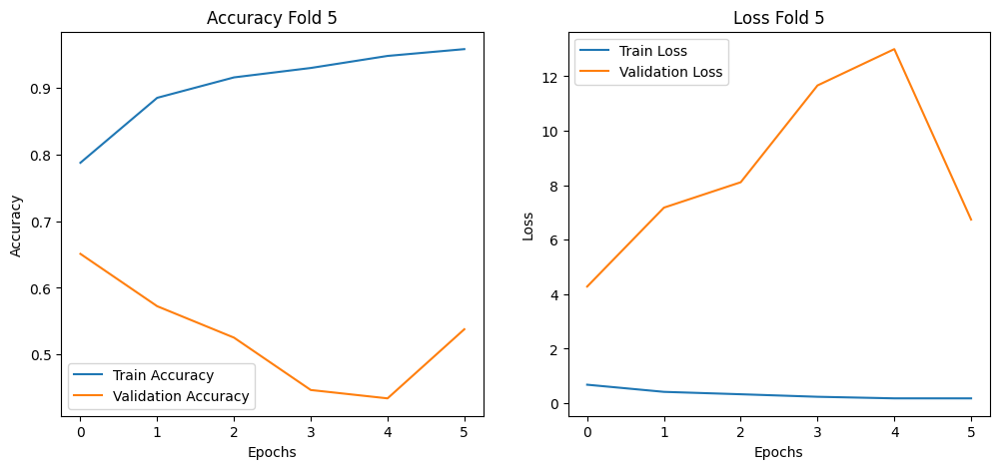


✅ Training selesai untuk semua fold!


In [6]:
# Stratified K-Fold
skf = StratifiedKFold(n_splits=K, shuffle=True, random_state=42)

# Melakukan K-Fold Cross Validation
for fold, (train_idx, val_idx) in enumerate(skf.split(df["filename"], df["label"])):
    print(f"\n🔹 Training Fold {fold+1}/{K}")

    # Membagi dataset berdasarkan indeks
    train_df = df.iloc[train_idx]
    val_df = df.iloc[val_idx]

    # Data augmentation dan preprocessing
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    train_generator = train_datagen.flow_from_dataframe(
        train_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=True
    )

    val_generator = val_datagen.flow_from_dataframe(
        val_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=False
    )

    # Buat model baru untuk setiap fold
    model = create_model()

    # Callback untuk early stopping dan penyimpanan model terbaik
    early_stopping = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)
    model_checkpoint = ModelCheckpoint(f"Batik_Nusantara_7_MobileNetV2_Fold{fold+1}.h5",
                                       monitor="val_loss", save_best_only=True, mode="min", verbose=1)

    # Training model
    history = model.fit(
        train_generator,
        validation_data=val_generator,
        epochs=EPOCHS,
        callbacks=[early_stopping, model_checkpoint],
        verbose=1
    )

    # 🔹 Plot Training & Validation Accuracy untuk Fold ini
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Accuracy Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # 🔹 Plot Training & Validation Loss untuk Fold ini
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Loss Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()  # Menampilkan plot setelah setiap fold selesai

print("\n✅ Training selesai untuk semua fold!")


In [3]:
test_dir = "../../Dataset/Dataset_Nusantara_7_split_stratified/test"

# Preprocessing data testing
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    shuffle=False  # Agar urutan gambar tetap sama untuk semua model
)

# Evaluasi tiap model per fold
num_folds = 5  # Jumlah fold
models = [f"Batik_Nusantara_7_MobileNetV2_Fold{i+1}.h5" for i in range(num_folds)]

for i, model_path in enumerate(models):
    print(f"\n🔹 Evaluating Model Fold {i+1}: {model_path}")
    
    # Load model
    model = tf.keras.models.load_model(model_path)
    
    # Evaluasi model
    loss, accuracy = model.evaluate(test_generator, verbose=1)
    
    # Tampilkan hasil evaluasi
    print(f"✅ Fold {i+1}: Loss = {loss:.4f}, Accuracy = {accuracy:.4f}")


Found 398 images belonging to 7 classes.

🔹 Evaluating Model Fold 1: Batik_Nusantara_7_MobileNetV2_Fold1.h5


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


13/13 ━━━━━━━━━━━━━━━━━━━━ 15s 995ms/step - accuracy: 0.7589 - loss: 2.4364
✅ Fold 1: Loss = 2.5019, Accuracy = 0.7688

🔹 Evaluating Model Fold 2: Batik_Nusantara_7_MobileNetV2_Fold2.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 761ms/step - accuracy: 0.5961 - loss: 3.2062
✅ Fold 2: Loss = 3.0703, Accuracy = 0.6231

🔹 Evaluating Model Fold 3: Batik_Nusantara_7_MobileNetV2_Fold3.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 762ms/step - accuracy: 0.7653 - loss: 1.6820
✅ Fold 3: Loss = 1.4600, Accuracy = 0.7965

🔹 Evaluating Model Fold 4: Batik_Nusantara_7_MobileNetV2_Fold4.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 11s 734ms/step - accuracy: 0.6655 - loss: 4.8950
✅ Fold 4: Loss = 3.4912, Accuracy = 0.7588

🔹 Evaluating Model Fold 5: Batik_Nusantara_7_MobileNetV2_Fold5.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 11s 740ms/step - accuracy: 0.5169 - loss: 6.0180
✅ Fold 5: Loss = 4.4091, Accuracy = 0.6307


Evaluasi Model KFold 1

13/13 ━━━━━━━━━━━━━━━━━━━━ 13s 914ms/step


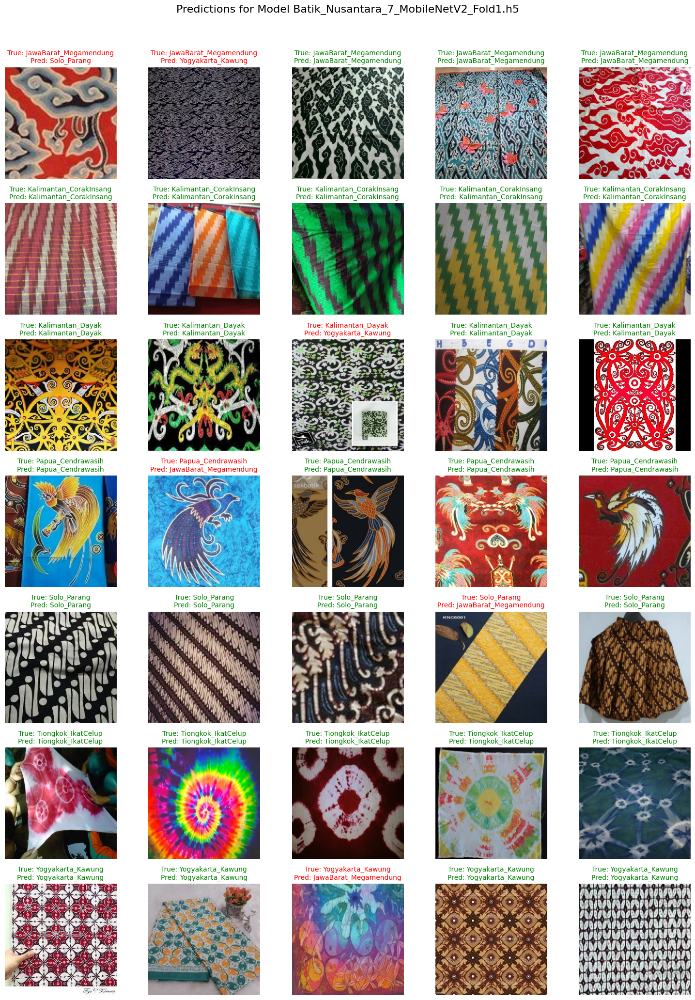

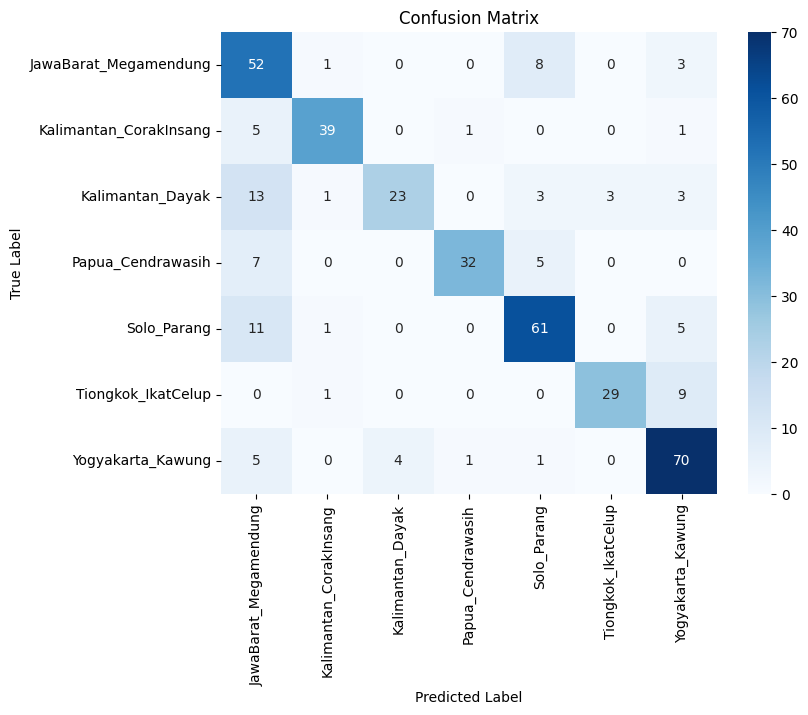

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.56      0.81      0.66        64
Kalimantan_CorakInsang       0.91      0.85      0.88        46
      Kalimantan_Dayak       0.85      0.50      0.63        46
     Papua_Cendrawasih       0.94      0.73      0.82        44
           Solo_Parang       0.78      0.78      0.78        78
    Tiongkok_IkatCelup       0.91      0.74      0.82        39
     Yogyakarta_Kawung       0.77      0.86      0.81        81

              accuracy                           0.77       398
             macro avg       0.82      0.75      0.77       398
          weighted avg       0.80      0.77      0.77       398



In [4]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold1.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13752\3700777095.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


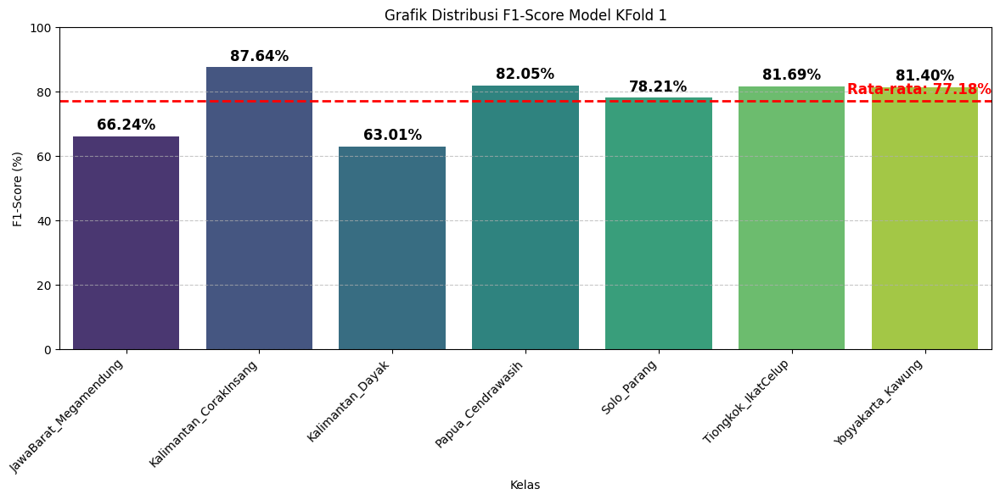

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 1")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 2

13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 883ms/step


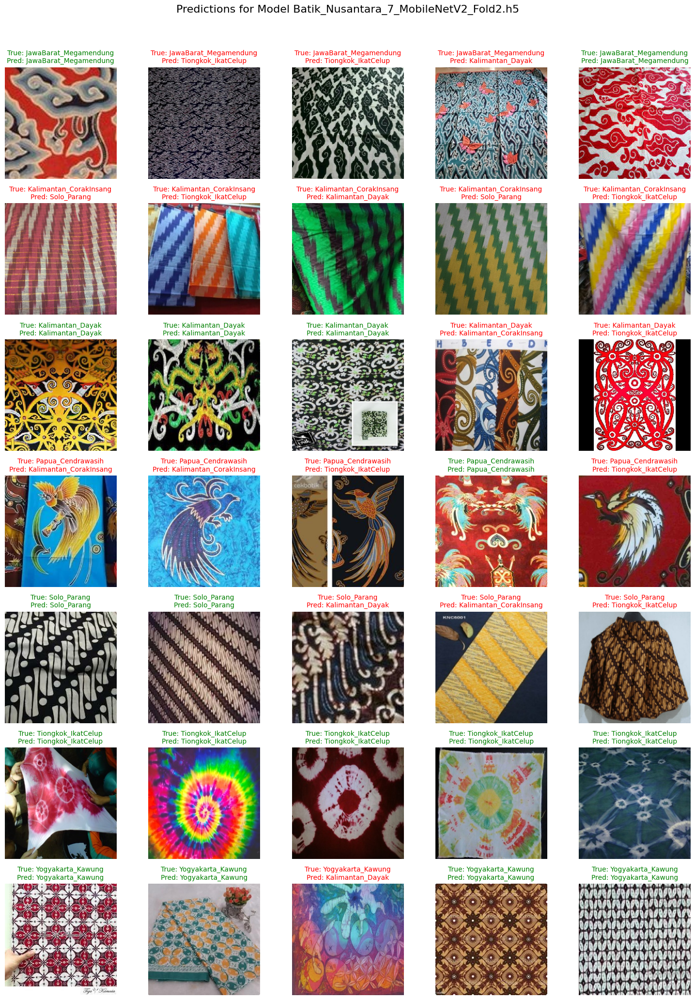

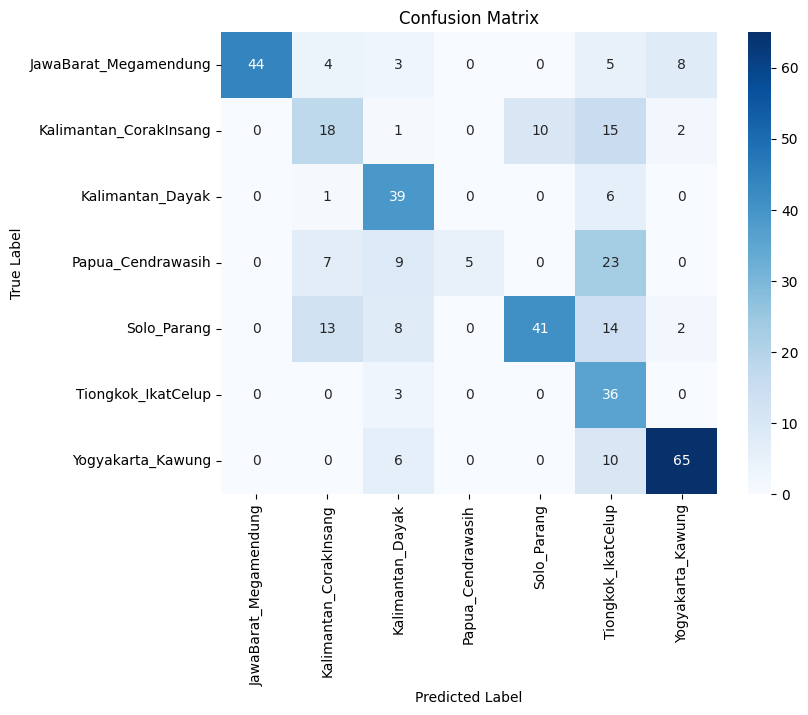

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       1.00      0.69      0.81        64
Kalimantan_CorakInsang       0.42      0.39      0.40        46
      Kalimantan_Dayak       0.57      0.85      0.68        46
     Papua_Cendrawasih       1.00      0.11      0.20        44
           Solo_Parang       0.80      0.53      0.64        78
    Tiongkok_IkatCelup       0.33      0.92      0.49        39
     Yogyakarta_Kawung       0.84      0.80      0.82        81

              accuracy                           0.62       398
             macro avg       0.71      0.61      0.58       398
          weighted avg       0.75      0.62      0.62       398



In [6]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold2.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13752\2186660190.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


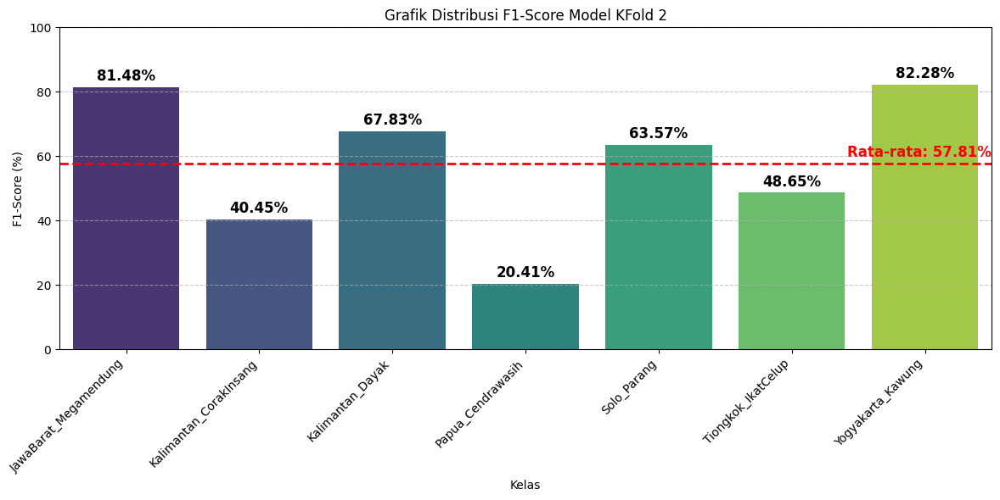

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 2")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 3

13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 865ms/step


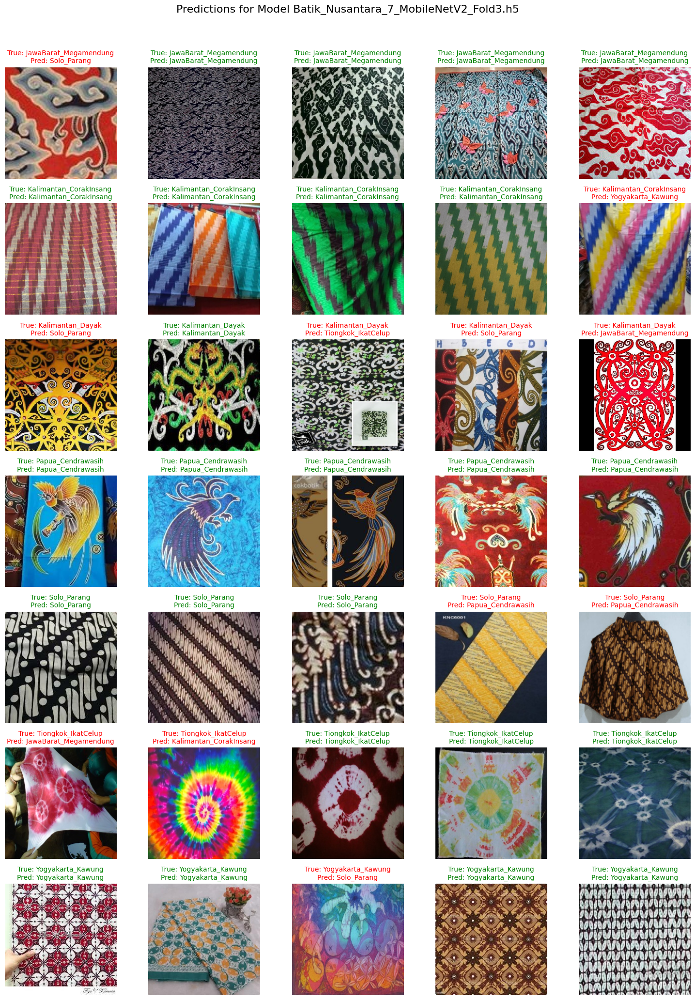

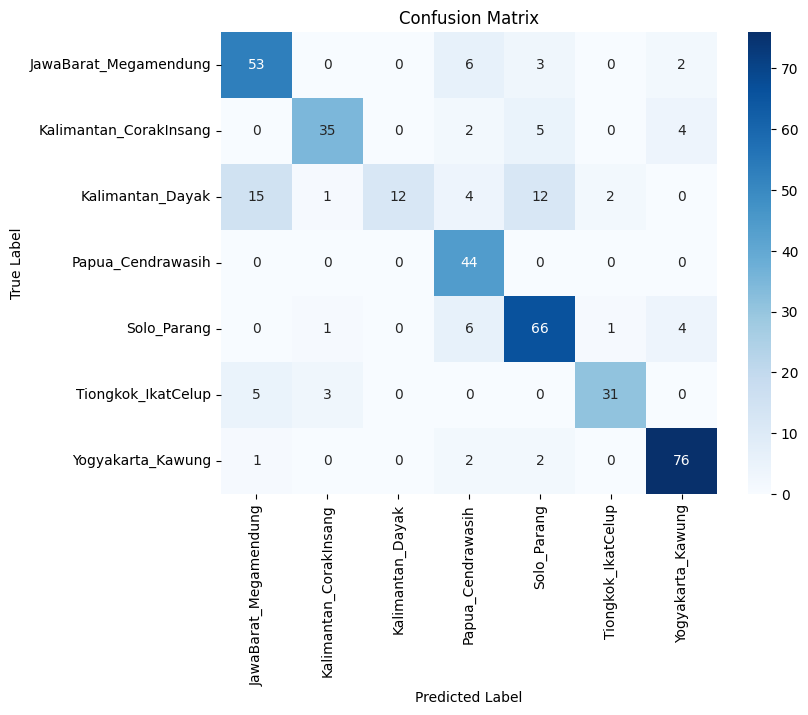

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.72      0.83      0.77        64
Kalimantan_CorakInsang       0.88      0.76      0.81        46
      Kalimantan_Dayak       1.00      0.26      0.41        46
     Papua_Cendrawasih       0.69      1.00      0.81        44
           Solo_Parang       0.75      0.85      0.80        78
    Tiongkok_IkatCelup       0.91      0.79      0.85        39
     Yogyakarta_Kawung       0.88      0.94      0.91        81

              accuracy                           0.80       398
             macro avg       0.83      0.78      0.77       398
          weighted avg       0.82      0.80      0.78       398



In [8]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold3.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13752\358054296.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


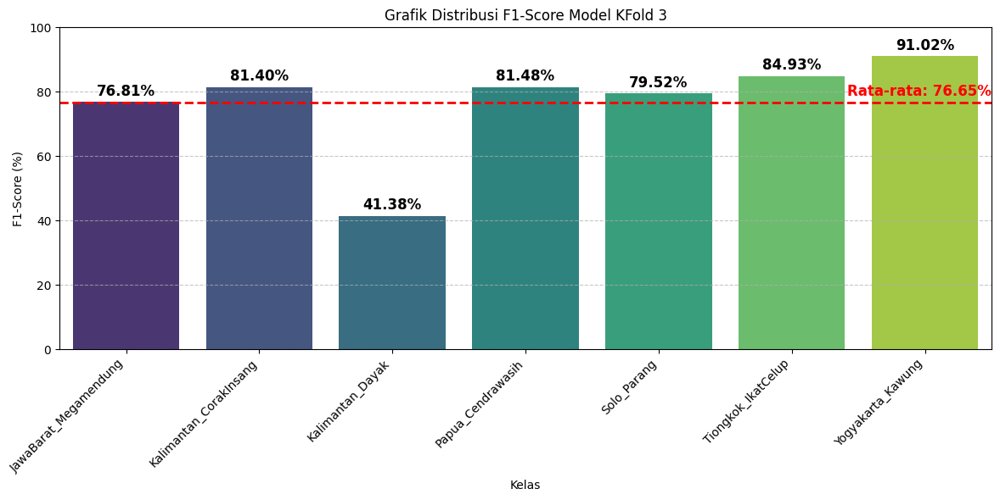

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 3")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 4

13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 875ms/step


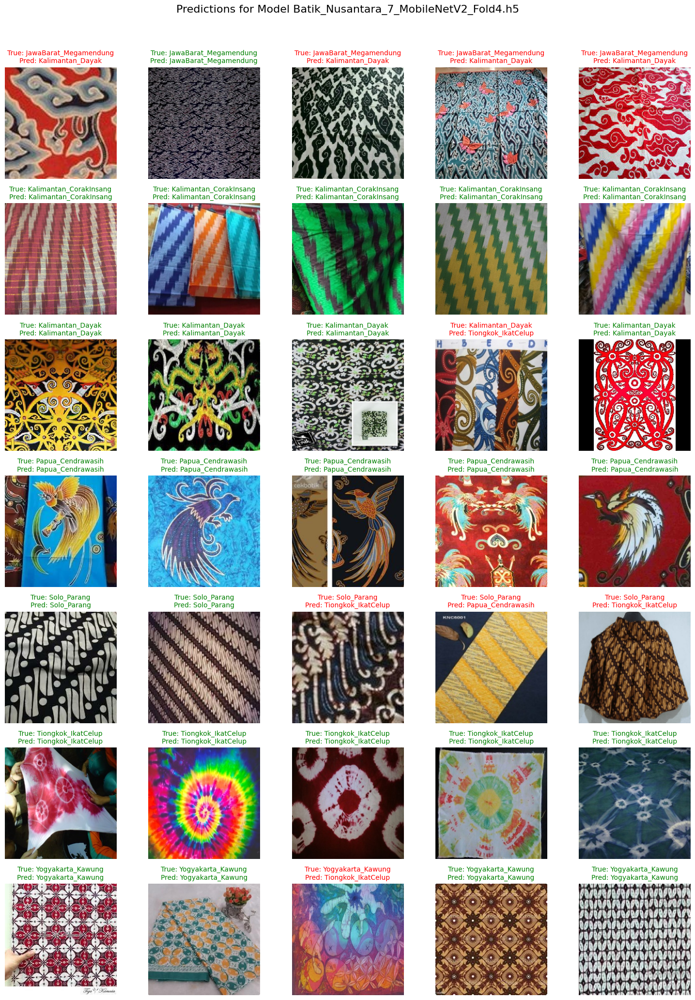

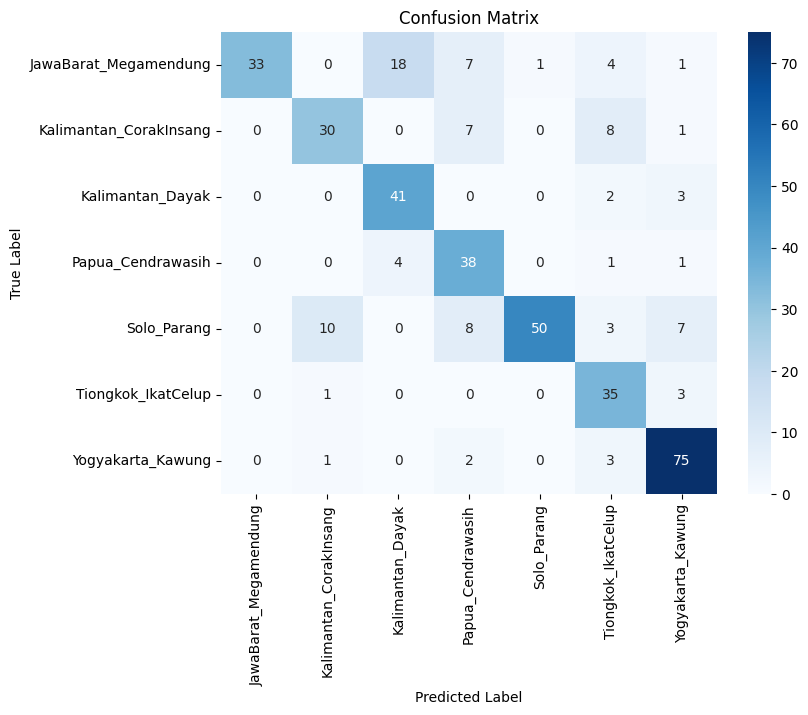

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       1.00      0.52      0.68        64
Kalimantan_CorakInsang       0.71      0.65      0.68        46
      Kalimantan_Dayak       0.65      0.89      0.75        46
     Papua_Cendrawasih       0.61      0.86      0.72        44
           Solo_Parang       0.98      0.64      0.78        78
    Tiongkok_IkatCelup       0.62      0.90      0.74        39
     Yogyakarta_Kawung       0.82      0.93      0.87        81

              accuracy                           0.76       398
             macro avg       0.77      0.77      0.75       398
          weighted avg       0.81      0.76      0.76       398



In [10]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold4.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13752\276641823.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


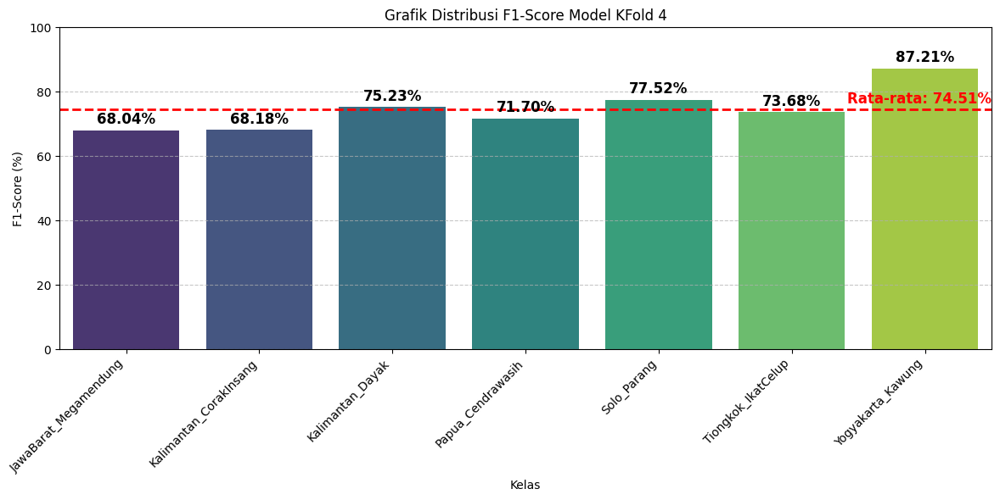

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 4")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 5

13/13 ━━━━━━━━━━━━━━━━━━━━ 13s 869ms/step


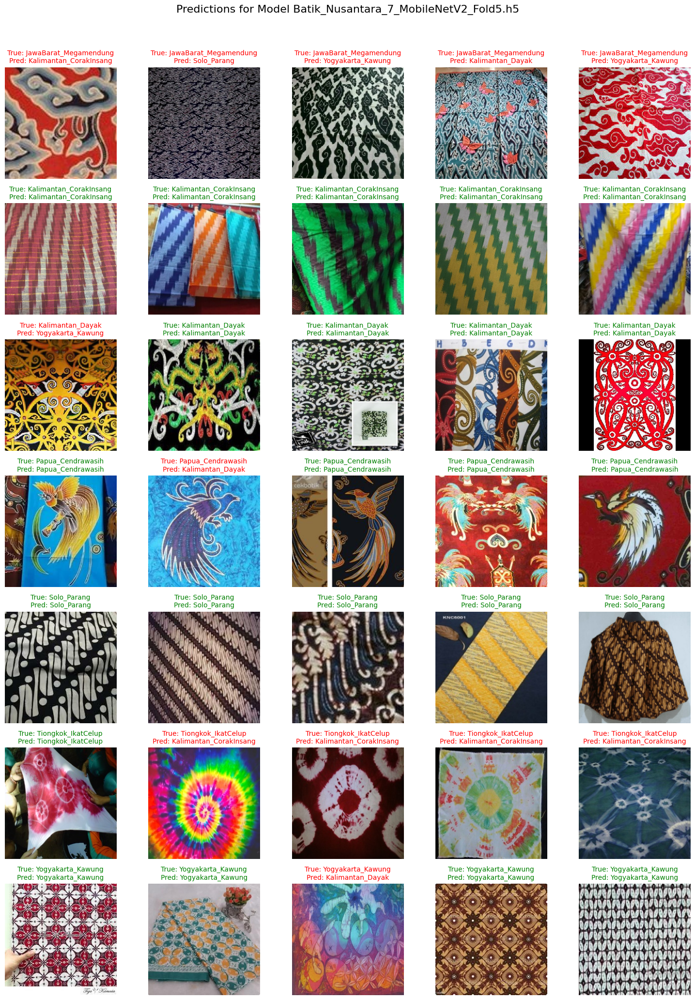

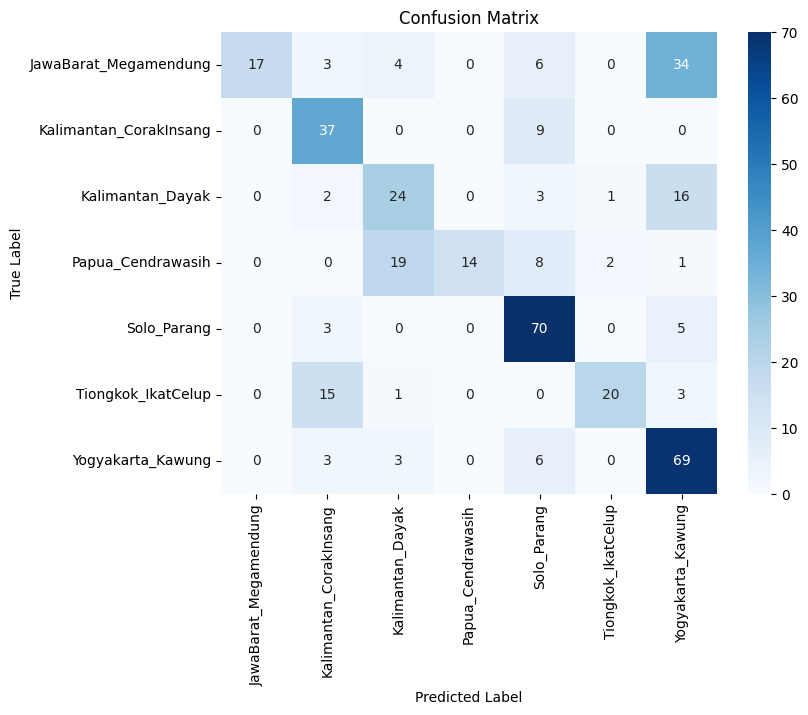

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       1.00      0.27      0.42        64
Kalimantan_CorakInsang       0.59      0.80      0.68        46
      Kalimantan_Dayak       0.47      0.52      0.49        46
     Papua_Cendrawasih       1.00      0.32      0.48        44
           Solo_Parang       0.69      0.90      0.78        78
    Tiongkok_IkatCelup       0.87      0.51      0.65        39
     Yogyakarta_Kawung       0.54      0.85      0.66        81

              accuracy                           0.63       398
             macro avg       0.74      0.60      0.59       398
          weighted avg       0.72      0.63      0.61       398



In [12]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold5.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13752\4055511063.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


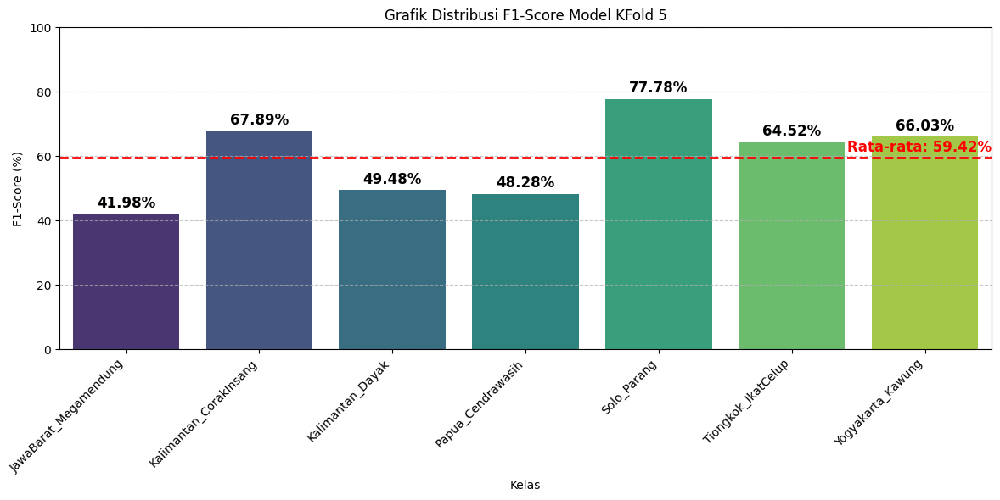

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 5")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


In [20]:
from tensorflow.keras.preprocessing import image

# load model
loaded_model = tf.keras.models.load_model('Batik_Nusantara_7_MobileNetV2_Fold3.h5')

# Path ke direktori dataset
dataset_dir = "../../Dataset/Dataset_Nusantara_7_split_stratified/test"

# Ambil nama kelas dari subdirektori
class_names = sorted(os.listdir(dataset_dir))
print("Nama Kelas:", class_names)

# Load dan preprocess gambar
# img_path = "../../Dataset/Dataset_Nusantara_7_split/test/Papua_Cendrawasih/Papua_Cendrawasih107.jpg"
img_path = "../../test_kawung_foto.jpeg"

img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan dengan ukuran input model
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Tambahkan dimensi batch
img_array = preprocess_input(img_array)  # Sesuaikan preprocessing dengan model Anda

# Prediksi
predictions = loaded_model.predict(img_array)
predicted_class_indices = np.argmax(predictions, axis=1)

# Map indeks prediksi ke nama kelas
predicted_class_name = class_names[predicted_class_indices[0]]
print("Predicted Class Index:", predicted_class_indices[0])
print("Predicted Class Name:", predicted_class_name)
print(predictions)

Nama Kelas: ['JawaBarat_Megamendung', 'Kalimantan_CorakInsang', 'Kalimantan_Dayak', 'Papua_Cendrawasih', 'Solo_Parang', 'Tiongkok_IkatCelup', 'Yogyakarta_Kawung']


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Predicted Class Index: 6
Predicted Class Name: Yogyakarta_Kawung
[[1.0332408e-08 3.2171847e-09 1.3050344e-04 5.7060295e-10 1.0336419e-04
  1.7875101e-06 9.9976438e-01]]


In [1]:
import numpy as np

# Contoh hasil akurasi dari 5 fold 
accuracies = [ 76.88, 62.31, 79.65, 75.88, 63.07 ]

# Menghitung standar deviasi
std_dev = np.std(accuracies)
mean = np.mean(accuracies)

print(f"standar Deviasi Akurasi Model: {std_dev:.4f}")
print(f"Rata-rata akurasi Model: {mean:.4f}")

standar Deviasi Akurasi Model: 7.3492
Rata-rata akurasi Model: 71.5580
